# Préparation de l'environnement

## Import des modules et librairies

In [1]:
#!pip install mlflow --quiet
#!pip install ydata_profiling --quiet
#!pip install shap --quiet
#!pip install evidently --quiet

In [21]:
import imblearn
print("imblearn Version : {}".format(imblearn.__version__))

imblearn Version : 0.11.0


In [2]:
# import des librairies utiles
# générales
import os
import numpy as np
import pandas as pd
import gc
import time
import re
from contextlib import contextmanager
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore")

# exploration rapide des données
from ydata_profiling import ProfileReport

from sklearn import set_config
set_config(transform_output="pandas")
set_config(display='diagram')
#set_config(display='text')

# pipeline
from imblearn.pipeline import Pipeline
from sklearn.pipeline import FeatureUnion

# prep-processing
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from sklearn.preprocessing import StandardScaler
from category_encoders import TargetEncoder
from sklearn.compose import ColumnTransformer

# classifier
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from lightgbm.sklearn import LGBMClassifier
#from lightgbm import LGBMClassifier

# model selection
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate, GridSearchCV

# metrics
from sklearn.metrics import roc_auc_score, accuracy_score, fbeta_score, make_scorer
#from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# threshold selection
from yellowbrick.classifier import DiscriminationThreshold
import numpy.ma as ma

# importance
import shap
print("SHAP Version : {}".format(shap.__version__))
shap.initjs()

# gestion des expériences
import mlflow
import mlflow.sklearn
from mlflow import log_artifacts, log_metric, log_param
from mlflow import MlflowClient
from pprint import pprint
print("MLFlow Version : {}".format(mlflow.__version__))

# stockage du modèle et de l'explainer
import joblib

# data drift
#import evidently
#from evidently.report import Report
#from evidently.metric_preset import DataDriftPreset, TargetDriftPreset
#from evidently.metrics import ColumnDriftMetric, DataDriftTable

SHAP Version : 0.43.0


MLFlow Version : 2.7.1


## Gestion des expérimentations

In [4]:
# start MLFlow tracking server
client = MlflowClient(tracking_uri="http://127.0.0.1:5000")

# Modélisation

## Définition des métriques

Le coût métier entre un faux négatif (FN - mauvais client prédit bon client : donc crédit accordé et perte en capital) et un faux positif (FP - bon client prédit mauvais : donc refus crédit et manque à gagner en marge) n'est pas le même !
On suppose ici que le coût d’un FN est dix fois supérieur au coût d’un FP pour créer un score “métier” basé sur la fonction fbeta_score avec beta = 10.

Ce score métier nous servira à comparer les modèles, afin de choisir le meilleur et ses meilleurs hyperparamètres, conjointement à des mesures plus techniques, telles que l’AUC, l’accuracy et le temps d'entraînement.

Une fois le meilleur modèle choisi et ses hyperparamètres optimisés, nous effectuerons une recherche du seuil qui détermine la classe 0 ou 1 avec la meilleure valeur du score métier afin de finaliser le modèle.


In [5]:
scoring = {'accuracy': 'accuracy',
           'auc': 'roc_auc', #make_scorer(roc_auc_score),
           'f10_score': make_scorer(fbeta_score, beta=10, average='weighted'),
           }

## Pre-processing

Il était fortement recommandé dans l'énoncé d'utiliser au maximum le Kaggle fourni afin de ne pas passer trop temps sur la partie exploration et pre-processing des données, dans la mesure où il ne s'agit pas de l'objectif principal de ce projet.

Nous avons donc suivi la recommandation et utilisé quasi sans modification les fonctions de pre-processing proposées.

In [9]:
# Feature engineering hors pipeline de application_train.csv et application_test.csv
df = pd.read_csv('./input/application_train.csv')
test_df = pd.read_csv('./input/application_test.csv')
print("Train samples: {}, test samples: {}".format(len(df), len(test_df)))
df = df.append(test_df).reset_index()
# Remove applications with XNA CODE_GENDER / ORGANIZATION TYPE (train set)
df = df[df['CODE_GENDER'] != 'XNA']
df = df[df['ORGANIZATION_TYPE'] != 'XNA']

# Categorical features with Binary encode (0 or 1; two categories)
for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
    df[bin_feature], uniques = pd.factorize(df[bin_feature])

# NaN values for DAYS_EMPLOYED: 365.243 -> nan
df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']

df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

del test_df
gc.collect()

Train samples: 307511, test samples: 48744


396

In [7]:
df.head(5)

,index,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,...,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC,INCOME_PER_PERSON,ANNUITY_INCOME_PERC,PAYMENT_RATE
0,0,100002,1.0,Cash loans,0,0,0,0,202500.0,406597.5,...,0.0,0.0,0.0,0.0,1.0,0.067329,0.498036,202500.0,0.121978,0.060749
1,1,100003,0.0,Cash loans,1,0,1,0,270000.0,1293502.5,...,0.0,0.0,0.0,0.0,0.0,0.070862,0.208736,135000.0,0.132217,0.027598
2,2,100004,0.0,Revolving loans,0,1,0,0,67500.0,135000.0,...,0.0,0.0,0.0,0.0,0.0,0.011814,0.500000,67500.0,0.100000,0.050000
3,3,100006,0.0,Cash loans,1,0,0,0,135000.0,312682.5,...,NaN,NaN,NaN,NaN,NaN,0.159905,0.431748,67500.0,0.219900,0.094941
4,4,100007,0.0,Cash loans,0,0,0,0,121500.0,513000.0,...,0.0,0.0,0.0,0.0,0.0,0.152418,0.236842,121500.0,0.179963,0.042623


In [8]:
df.dtypes

index                    int64
SK_ID_CURR               int64
TARGET                 float64
NAME_CONTRACT_TYPE      object
CODE_GENDER              int64
                        ...   
DAYS_EMPLOYED_PERC     float64
INCOME_CREDIT_PERC     float64
INCOME_PER_PERSON      float64
ANNUITY_INCOME_PERC    float64
PAYMENT_RATE           float64
Length: 128, dtype: object

In [10]:
# split entre training et test data
train_df = df[df['TARGET'].notnull()]
test_df = df[df['TARGET'].isnull()]

# split entre features et target
feats = [col for col in train_df.columns if col not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
X_train = train_df[feats]
y_train = train_df['TARGET']

# préparation spécifique pour le sampling via SMOTE
X_train = X_train.dropna(axis=1)

# test data
feats = X_train.columns
X_test = test_df[feats]

In [13]:
# définition d'une pipeline de pre-processing pour éviter le data leakage
cat_cols = [col for col in X_train.columns if X_train[col].dtype == 'object']
other_cols = [col for col in X_train.columns if X_train[col].dtype != 'object']

cat_pipeline = Pipeline([
    ('t_enc', TargetEncoder(verbose=1, smoothing=2, min_samples_leaf=2,handle_unknown='return_nan')),
    ('std_scaler', StandardScaler())
    ])

other_pipeline = Pipeline([
    ('std_scaler', StandardScaler()) 
    ])

preprocessor = ColumnTransformer([
    ('cat_pipeline', cat_pipeline, cat_cols),
    ('other_pipeline', other_pipeline, other_cols) 
],verbose_feature_names_out = False).set_output(transform="pandas")

preprocessor

ColumnTransformer(transformers=[('cat_pipeline',
                                 Pipeline(steps=[('t_enc',
                                                  TargetEncoder(handle_unknown='return_nan',
                                                                min_samples_leaf=2,
                                                                smoothing=2,
                                                                verbose=1)),
                                                 ('std_scaler',
                                                  StandardScaler())]),
                                 ['NAME_CONTRACT_TYPE', 'NAME_INCOME_TYPE',
                                  'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
                                  'NAME_HOUSING_TYPE',
                                  'WEEKDAY_APPR_PROCESS_START',
                                  'ORGANIZATION_TYPE']),
                                ('o...
                                  'FLAG_EMAIL', 'REGION_RATING_CLIENT',
                                  'REGION_RATING_CLIENT_W_CITY',
                                  'HOUR_APPR_PROCESS_START',
                                  'REG_REGION_NOT_LIVE_REGION',
                                  'REG_REGION_NOT_WORK_REGION',
                                  'LIVE_REGION_NOT_WORK_REGION',
                                  'REG_CITY_NOT_LIVE_CITY',
                                  'REG_CITY_NOT_WORK_CITY',
                                  'LIVE_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_2',
                                  'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4',
                                  'FLAG_DOCUMENT_5', ...])],
                  verbose_feature_names_out=False)

In [77]:
X_train_preprocessed = preprocessor.fit_transform(X_train, y_train) 
X_train_preprocessed

,NAME_CONTRACT_TYPE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,...,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC
0,0.338420,0.715149,0.589771,1.606235,-0.287393,0.097270,0.380668,-1.286570,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,-0.670404,0.165428
1,0.338420,-2.237184,-1.618381,-0.542667,-0.287393,-1.384128,-1.634162,0.777261,-0.773720,1.452805,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,-0.643949,-0.367802
2,-2.954908,0.715149,0.589771,1.606235,-0.287393,-1.384128,-1.001222,-1.286570,1.292458,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,-1.086102,0.169048
3,0.338420,0.715149,0.589771,1.570916,-0.287393,0.097270,0.380668,0.777261,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,0.022805,0.043248
4,0.338420,0.715149,0.589771,1.606235,-0.287393,0.553458,-1.653455,-1.286570,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,-0.033258,-0.315997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307504,0.338420,0.715149,0.589771,0.035240,-0.287393,0.097270,0.901081,0.777261,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,2.078817,0.097081
307506,0.338420,0.715149,0.589771,0.035240,3.197679,0.553458,-1.224387,-1.286570,-0.773720,1.452805,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,-0.985094,0.387233
307508,0.338420,0.715149,-1.618381,0.035240,-0.287393,0.553458,-1.634162,0.777261,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,2.788569,-0.336394
307509,0.338420,-0.905371,0.589771,-0.542667,-0.287393,0.097270,-0.309757,0.777261,-0.773720,-0.688324,...,-0.059552,-0.038023,-0.109864,-0.017927,-0.099668,-0.026654,-0.024802,-0.020216,1.821628,0.099061


In [73]:
X_train_preprocessed.columns.to_list()

['cat_pipeline__NAME_CONTRACT_TYPE',
 'cat_pipeline__NAME_INCOME_TYPE',
 'cat_pipeline__NAME_EDUCATION_TYPE',
 'cat_pipeline__NAME_FAMILY_STATUS',
 'cat_pipeline__NAME_HOUSING_TYPE',
 'cat_pipeline__WEEKDAY_APPR_PROCESS_START',
 'cat_pipeline__ORGANIZATION_TYPE',
 'other_pipeline__CODE_GENDER',
 'other_pipeline__FLAG_OWN_CAR',
 'other_pipeline__FLAG_OWN_REALTY',
 'other_pipeline__CNT_CHILDREN',
 'other_pipeline__AMT_INCOME_TOTAL',
 'other_pipeline__AMT_CREDIT',
 'other_pipeline__REGION_POPULATION_RELATIVE',
 'other_pipeline__DAYS_BIRTH',
 'other_pipeline__DAYS_EMPLOYED',
 'other_pipeline__DAYS_REGISTRATION',
 'other_pipeline__DAYS_ID_PUBLISH',
 'other_pipeline__FLAG_MOBIL',
 'other_pipeline__FLAG_EMP_PHONE',
 'other_pipeline__FLAG_WORK_PHONE',
 'other_pipeline__FLAG_CONT_MOBILE',
 'other_pipeline__FLAG_PHONE',
 'other_pipeline__FLAG_EMAIL',
 'other_pipeline__REGION_RATING_CLIENT',
 'other_pipeline__REGION_RATING_CLIENT_W_CITY',
 'other_pipeline__HOUR_APPR_PROCESS_START',
 'other_pipeli

In [12]:
sampling = SMOTE(random_state=42)
clf = DummyClassifier()

steps = [('preprocessing', preprocessor), ('sampler', sampling), ('classifier', clf)]

model = Pipeline(steps=steps)
model

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('cat_pipeline',
                                                  Pipeline(steps=[('t_enc',
                                                                   TargetEncoder(handle_unknown='return_nan',
                                                                                 min_samples_leaf=2,
                                                                                 smoothing=2,
                                                                                 verbose=1)),
                                                                  ('std_scaler',
                                                                   StandardScaler())]),
                                                  ['NAME_CONTRACT_TYPE',
                                                   'NAME_INCOME_TYPE',
                                                   'NAME_EDUCATION_TYPE',
                                                   'NAME_FAMILY_STATUS',
                                                   'NAME_HOUSING_TYPE',
                                                   'WEEKDAY_APPR_PROCESS...
                                                   'REGION_RATING_CLIENT_W_CITY',
                                                   'HOUR_APPR_PROCESS_START',
                                                   'REG_REGION_NOT_LIVE_REGION',
                                                   'REG_REGION_NOT_WORK_REGION',
                                                   'LIVE_REGION_NOT_WORK_REGION',
                                                   'REG_CITY_NOT_LIVE_CITY',
                                                   'REG_CITY_NOT_WORK_CITY',
                                                   'LIVE_CITY_NOT_WORK_CITY',
                                                   'FLAG_DOCUMENT_2',
                                                   'FLAG_DOCUMENT_3',
                                                   'FLAG_DOCUMENT_4',
                                                   'FLAG_DOCUMENT_5', ...])])),
                ('sampler', SMOTE(random_state=42)),
                ('classifier', DummyClassifier())])

## Fonctions de modélisation

In [13]:
# récupération du score moyen sur les différentes métriques d'évaluation
def avg_score_cv_classif(model, X, y, cv, scoring=scoring):
    """
    Evaluates a given model/estimator using cross-validation
    and returns a dict containing the absolute vlues of the average (mean) scores
    for classification models.

    clf: scikit-learn classification model
    X: features (no labels)
    y: labels
    scoring: a dictionary of scoring metrics
    cv: cross-validation strategy
    """
    # Score metrics on cross-validated dataset
    scores_dict = cross_validate(model, X, y, cv=cv, scoring=scoring, n_jobs=-1)

    # return the average scores for each metric
    return {metric: round(np.mean(scores), 5) for metric, scores in scores_dict.items()}

In [14]:
# calcul des scores d'un modèle entraîné avec folds
def scores_folds(experiment_name, sampling, clf, desc, X_train=X_train):
    
    # Use the fluent API to set the tracking uri and the active experiment
    mlflow.set_tracking_uri("http://127.0.0.1:5000")

    # Sets the current active experiment to the "Apple_Models" experiment and returns the Experiment metadata
    client_scoring_experiment = mlflow.set_experiment(experiment_name)

    # Define a run name for this iteration of training.
    run_name = desc

    # Define an artifact path that the model will be saved to.
    artifact_path = desc

    # définition d'une pipeline
    steps = [('preprocessing', preprocessor), ('sampler', sampling), ('classifier', clf)]

    model = Pipeline(steps=steps)

    # cross validation
    folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)

    # entraînement du modèle avec cross validation et récupération des scores
    scores = avg_score_cv_classif(model, X_train, y_train, cv=folds, scoring=scoring)

    model.fit(X_train, y_train)
    
    # Initiate the MLflow run context
    nb_features = X_train.shape[1]
    
    with mlflow.start_run(run_name=run_name) as run:
        # Log the parameters used for the model fit
        #mlflow.log_params(params)
        mlflow.log_param('classifier', clf)
        mlflow.log_param('sampler', sampling)
        mlflow.log_param('features', nb_features)

        # Log the error metrics that were calculated during validation
        mlflow.log_metrics(scores)

        # Log an instance of the trained model for later use
        mlflow.sklearn.log_model(sk_model=model, input_example=X_train, artifact_path=artifact_path)

    return model

In [15]:
# affichage du nom de l'estimateur
def estimator_name(estimator):
    estimator_name = estimator.__class__.__name__
    return estimator_name

In [15]:
# REMOVE création d'une fonction timer
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

## Tests de classifieurs
Dans ce qui suit, nous testons l'utilisation de 4 options assez standards de classifieurs, en commençant par un DummyClassifier qui servira de baseline.

Ensuite, nous testerons DecisionTreeClassifier, RandomForestClassifier et LightGBM.
SVC semblait beaucoup trop long à exécuter ; nous avons donc abandonné cette piste.

In [30]:
# create a new experiment to test several classifiers for this projet
experiment_description = (
    "This is the client scoring project. "
    "This experiment contains all initial runs to select the best classifier."
)

experiment_tags = {
    "project_name": "client-scoring",
    "mlflow.note.content": experiment_description,
}

best_classifier_experiment = client.create_experiment(name="Best_Classifier2", tags=experiment_tags)

In [55]:
sampling = SMOTE(random_state=42)
clf = DummyClassifier()

model_scores = scores_folds("Best_Classifier2", sampling, clf, str(clf))

In [56]:
clf = DecisionTreeClassifier()

model_scores = scores_folds("Best_Classifier2", sampling, clf, str(clf))

In [57]:
clf = RandomForestClassifier(n_estimators=10, n_jobs=-1)

model_scores = scores_folds("Best_Classifier2", sampling, clf, str(clf))

In [59]:
clf = LGBMClassifier(n_estimators=10, verbose=-1, n_jobs=-1)

model_scores = scores_folds("Best_Classifier2", sampling, clf, str(clf))

On sélectionne le modèle lightGBM qui présente les meilleures performances

## Choix de la stratégie d'équilibrage

Nous avons utilisé SMOTE par défaut puisqu'il s'agissait de la méthode préconisée par l'énoncé. Nous avons malgré tout voulu tester d'autres méthodes.

In [60]:
# create a new experiment to test several class imbalance strategies
experiment_description = (
    "This is the client scoring project. "
    "This experiment contains all runs to select the best class imbalance strategy."
)

experiment_tags = {
    "project_name": "client-scoring",
    "mlflow.note.content": experiment_description,
}

imbalance_strategy_experiment = client.create_experiment(name="Imbalance_Strategy2", tags=experiment_tags)

### RandomOverSampler

In [81]:
clf = LGBMClassifier(n_estimators=50, verbose=-1, n_jobs=-1)
sampling = RandomOverSampler(random_state=42)

model_scores = scores_folds("Imbalance_Strategy2", sampling, clf, str(sampling))

### RandomUnderSampler

In [82]:
sampling = RandomUnderSampler(random_state=42)

model_scores = scores_folds("Imbalance_Strategy2", sampling, clf, str(sampling))

### Class weight = 'balanced'



In [83]:
sampling = None
clf = LGBMClassifier(n_estimators=50, verbose=-1, n_jobs=-1, class_weight= 'balanced')

model_scores = scores_folds("Imbalance_Strategy2", sampling, clf, desc = 'class_weight')

La méthode SMOTE semble être la meilleure dans notre situation puisqu'elle génère le business score le plus important.
Pour aller plus loin, elle pourrait être combinée avec class_weight, en passant cet élément comme hyperparamètre dans une GridSearch.

Dans la mesure où l'objectif de ce projet n'était pas d'améliorer significativement la performance du modèle, nous n'avons pas investi plus de temps là dessus.

## Sélection des features

Il y a 55 features pour commencer dans cet exercice de modélisation.
Nous allons voir si nous pouvons améliorer la performance du modèle et simplifier son utilisation en réduisant le nombre de features.

In [102]:
# create a new experiment to test several classifiers for this projet
experiment_description = (
    "This is the client scoring project. "
    "This experiment contains all initial runs to select the best features."
)

experiment_tags = {
    "project_name": "client-scoring",
    "mlflow.note.content": experiment_description,
}

best_features_experiment = client.create_experiment(name="Feature_selection", tags=experiment_tags)

In [132]:
sampling = SMOTE(random_state=42)
clf = LGBMClassifier(n_estimators=50, verbose=-1, n_jobs=-1)

model_scores = scores_folds("Feature_selection", sampling, clf, desc = 'all'+str(clf))

In [133]:
clf = ExtraTreesClassifier(n_estimators=50)
clf = clf.fit(X_train_preprocessed, y_train)
clf.feature_importances_  

array([3.22142558e-03, 2.46694352e-02, 2.14639728e-02, 3.31378865e-02,
       2.11989371e-02, 5.11922188e-02, 5.63295041e-02, 8.90953818e-03,
       1.16860543e-02, 2.08128185e-02, 3.53062011e-02, 5.91498042e-02,
       5.93413527e-02, 5.75454591e-02, 6.43728474e-02, 6.21618204e-02,
       6.25600965e-02, 6.38047276e-02, 2.38280451e-07, 3.37046459e-05,
       1.55806906e-02, 6.53389723e-04, 1.48426578e-02, 9.84347275e-03,
       6.92377386e-03, 6.98730645e-03, 5.85371447e-02, 1.89531267e-03,
       4.65919467e-03, 4.07865739e-03, 4.32574581e-03, 5.56093949e-03,
       6.76104958e-03, 1.26606547e-04, 5.35149729e-03, 2.56796463e-06,
       2.38137212e-03, 1.13337835e-03, 7.91337474e-05, 3.70457193e-03,
       9.34839871e-04, 5.55403740e-07, 6.28070950e-04, 1.30896373e-07,
       5.37702920e-04, 5.25041448e-04, 2.83601643e-04, 2.12803126e-03,
       6.96412647e-05, 1.96169240e-03, 2.96159711e-04, 2.63555744e-04,
       2.14155314e-04, 6.23983326e-02, 5.94319820e-02])

In [143]:
selector = SelectFromModel(clf, prefit=True, threshold=-np.inf, max_features=40)
X_train_new = selector.transform(X_train)
X_train_new.shape

(252133, 40)

In [144]:
selected_features = selector.get_feature_names_out(X_train.columns)
selected_features

array(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
       'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_5',
       'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_18', 'DAYS_EMPLOYED_PERC',
       'INCOME_CREDIT_PERC'], dtype=object)

In [145]:
X_train_new.columns = selected_features

# préparation spécifique pour le sampling via SMOTE
X_train_new = X_train_new.dropna(axis=1)

X_train_new

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,ORGANIZATION_TYPE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC
0,Cash loans,0,0,0,0,202500.0,406597.5,Working,Secondary / secondary special,Single / not married,...,Business Entity Type 3,1,0,0,0,0,0,0,0.067329,0.498036
1,Cash loans,1,0,1,0,270000.0,1293502.5,State servant,Higher education,Married,...,School,1,0,0,0,0,0,0,0.070862,0.208736
2,Revolving loans,0,1,0,0,67500.0,135000.0,Working,Secondary / secondary special,Single / not married,...,Government,0,0,0,0,0,0,0,0.011814,0.5
3,Cash loans,1,0,0,0,135000.0,312682.5,Working,Secondary / secondary special,Civil marriage,...,Business Entity Type 3,1,0,0,0,0,0,0,0.159905,0.431748
4,Cash loans,0,0,0,0,121500.0,513000.0,Working,Secondary / secondary special,Single / not married,...,Religion,0,0,0,1,0,0,0,0.152418,0.236842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307504,Cash loans,1,0,0,0,153000.0,331920.0,Working,Secondary / secondary special,Separated,...,Self-employed,1,0,0,0,0,0,0,0.434481,0.460954
307506,Cash loans,0,0,1,0,157500.0,254700.0,Working,Secondary / secondary special,Separated,...,Services,0,0,0,1,0,0,0,0.025303,0.618375
307508,Cash loans,1,0,0,0,153000.0,677664.0,Working,Higher education,Separated,...,School,1,0,0,0,0,0,0,0.529266,0.225776
307509,Cash loans,1,0,0,0,171000.0,370107.0,Commercial associate,Secondary / secondary special,Married,...,Business Entity Type 1,1,0,0,0,0,0,0,0.400134,0.462029


In [146]:
# définition d'une pipeline de pre-processing pour éviter le data leakage
cat_cols = [col for col in X_train_new.columns if X_train_new[col].dtype == 'object']
other_cols = [col for col in X_train_new.columns if X_train_new[col].dtype != 'object']

cat_pipeline = Pipeline([
    ('t_enc', TargetEncoder(verbose=1, smoothing=2, min_samples_leaf=2,handle_unknown='ignore')),
    ('std_scaler', StandardScaler())
    ])

other_pipeline = Pipeline([
    ('std_scaler', StandardScaler()) 
    ])

preprocessor = ColumnTransformer([
    ('cat_pipeline', cat_pipeline, cat_cols),
    ('other_pipeline', other_pipeline, other_cols) 
])

preprocessor

ColumnTransformer(transformers=[('cat_pipeline',
                                 Pipeline(steps=[('t_enc',
                                                  TargetEncoder(handle_unknown='ignore',
                                                                min_samples_leaf=2,
                                                                smoothing=2,
                                                                verbose=1)),
                                                 ('std_scaler',
                                                  StandardScaler())]),
                                 ['NAME_CONTRACT_TYPE', 'CODE_GENDER',
                                  'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
                                  'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
                                  'AMT_CREDIT', 'NAME_INCOME_TYPE',
                                  'NAME_EDUCATION_TYPE', 'NAME...
                                  'REGION_RATING_CLIENT',
                                  'REGION_RATING_CLIENT_W_CITY',
                                  'WEEKDAY_APPR_PROCESS_START',
                                  'HOUR_APPR_PROCESS_START',
                                  'REG_REGION_NOT_LIVE_REGION',
                                  'REG_REGION_NOT_WORK_REGION',
                                  'LIVE_REGION_NOT_WORK_REGION',
                                  'REG_CITY_NOT_LIVE_CITY',
                                  'REG_CITY_NOT_WORK_CITY',
                                  'LIVE_CITY_NOT_WORK_CITY', ...]),
                                ('other_pipeline',
                                 Pipeline(steps=[('std_scaler',
                                                  StandardScaler())]),
                                 [])])

In [148]:
sampling = SMOTE(random_state=42)
clf = LGBMClassifier(n_estimators=50, verbose=-1, n_jobs=-1)

model_scores = scores_folds("Feature_selection", sampling, clf, '40'+str(clf), X_train=X_train_new)

## Optimisation des hyperparamètres pour le classifieur et la stratégie d'équilibrage retenus

Maintenant que nous avons choisi une méthode d'équilibrage des classes ainsi qu'un classifieur, nous allons tenter d'améliorer les performances du modèle global en faisant une recherche d'hyperparamètres.

In [116]:
# create a new experiment to tune hyperparameters
experiment_description = (
    "This is the client scoring project. "
    "This experiment contains the GridSearch conducted to tune hyperparameters."
)

experiment_tags = {
    "project_name": "client-scoring",
    "mlflow.note.content": experiment_description,
}

hyperparameter_tuning_experiment = client.create_experiment(name="Hyperparameter_Tuning2", tags=experiment_tags)

In [151]:
# préparation des données
sampling = SMOTE(random_state=42)

# définition d'une pipeline
clf = LGBMClassifier(n_estimators=50, verbose=-1, n_jobs=-1)

# définition d'une pipeline
steps = [('preprocessing', preprocessor), ('sampler', sampling), ('classifier', clf)]

model = Pipeline(steps=steps)

# hyperparamètres à optimiser
param_grid = {"classifier__max_depth": [6, 8, 10], "classifier__learning_rate": np.logspace(start=-2,stop=0, num=3)}

# cross validation
folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)

# optimisation des hyperparamètres
grid = GridSearchCV(model, param_grid=param_grid, cv=folds, refit='f10_score', scoring=scoring, return_train_score=True)
grid.fit(X_train, y_train)

# affichage des résulats de l'optimisation
cv_results = pd.DataFrame.from_dict(grid.cv_results_)
cv_results[['param_classifier__learning_rate', 'param_classifier__max_depth', 'rank_test_f10_score', 'mean_test_f10_score', 'mean_test_accuracy', 'mean_test_auc', 'mean_fit_time', 'mean_score_time']]

,param_classifier__learning_rate,param_classifier__max_depth,rank_test_f10_score,mean_test_f10_score,mean_test_accuracy,mean_test_auc,mean_fit_time,mean_score_time
0,0.01,6,9,0.751741,0.751131,0.605466,9.756614,1.117237
1,0.01,8,8,0.803774,0.803386,0.603188,10.611614,1.093303
2,0.01,10,7,0.848412,0.848401,0.602063,9.968690,1.203789
3,0.1,6,3,0.909917,0.910722,0.639904,9.595472,1.129044
4,0.1,8,2,0.911669,0.912506,0.641326,10.553299,1.214410
5,0.1,10,1,0.911800,0.912641,0.641448,10.653637,1.217188
6,1.0,6,4,0.905708,0.906446,0.642097,9.755718,1.099820
7,1.0,8,5,0.903955,0.904673,0.640654,9.679317,1.193477
8,1.0,10,6,0.903926,0.904646,0.641448,10.766458,1.231553


In [152]:
# affichage des résulats de l'optimisation
cv_results = pd.DataFrame.from_dict(grid.cv_results_)
cv_results = cv_results[['param_classifier__learning_rate', 'param_classifier__max_depth', 'rank_test_f10_score', 'mean_test_f10_score', 'mean_test_accuracy', 'mean_test_auc', 'mean_fit_time', 'mean_score_time']]

In [153]:
cv_results = cv_results.values

# Use the fluent API to set the tracking uri and the active experiment
mlflow.set_tracking_uri("http://127.0.0.1:5000")

# Sets the current active experiment to the "Apple_Models" experiment and returns the Experiment metadata
client_scoring_experiment = mlflow.set_experiment("Hyperparameter_Tuning2")

# Loop through each experiment result and save the results to a
# nested experiement within the experiment
for some_run in cv_results:
    with mlflow.start_run():
        # Define a run name for this iteration of training.
        run_name = 'gridrank' + str(some_run[2])
        # Define an artifact path that the model will be saved to.
        artifact_path = 'gridrank' + str(some_run[2])
        # Log model configuration/params
        params = {
            'classifier': clf,
            'sampler': sampling,
            'learning_rate': some_run[0],
            'max_depth': some_run[1]
            }
        mlflow.log_params(params)
        # Log metrics
        mlflow.log_metric('f10_score', some_run[3])
        mlflow.log_metric('accuracy', some_run[4])
        mlflow.log_metric('auc', some_run[5])
        mlflow.log_metric('fit_time', some_run[6])
        mlflow.log_metric('score_time', some_run[7])
    mlflow.end_run()

### Suivi des expérimentations
Via http://127.0.0.1:5000/#/experiments

## Modèle final

In [86]:
# create a new experiment to find the best decision threshold
experiment_description = (
    "This is the client scoring project. "
    "This experiment contains the models with different decision thresholds."
)

experiment_tags = {
    "project_name": "client-scoring",
    "mlflow.note.content": experiment_description,
}

decision_threshold_experiment = client.create_experiment(name="Decision_Threshold", tags=experiment_tags)

In [14]:
# classifier optimisé
sampling = SMOTE(random_state=42)
clf = LGBMClassifier(n_estimators=50, learning_rate=0.1,
                     max_depth = 10, verbose=-1, n_jobs=-1)

# création d'un dataset de validation
X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train,
                                                  random_state=42, test_size=0.3,
                                                  stratify=y_train)

# définition d'une pipeline
steps = [('preprocessing', preprocessor), ('sampler', sampling), ('classifier', clf)]

model = Pipeline(steps=steps)

# fit du modèle
model.fit(X_train2, y_train2)

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('cat_pipeline',
                                                  Pipeline(steps=[('t_enc',
                                                                   TargetEncoder(handle_unknown='return_nan',
                                                                                 min_samples_leaf=2,
                                                                                 smoothing=2,
                                                                                 verbose=1)),
                                                                  ('std_scaler',
                                                                   StandardScaler())]),
                                                  ['NAME_CONTRACT_TYPE',
                                                   'NAME_INCOME_TYPE',
                                                   'NAME_EDUCATION_TYPE',
                                                   'NAME_FAMILY_STATUS',
                                                   'NAME_HOUSING_TYPE',
                                                   'WEEKDAY_APPR_PROCESS...
                                                   'REG_REGION_NOT_WORK_REGION',
                                                   'LIVE_REGION_NOT_WORK_REGION',
                                                   'REG_CITY_NOT_LIVE_CITY',
                                                   'REG_CITY_NOT_WORK_CITY',
                                                   'LIVE_CITY_NOT_WORK_CITY',
                                                   'FLAG_DOCUMENT_2',
                                                   'FLAG_DOCUMENT_3',
                                                   'FLAG_DOCUMENT_4',
                                                   'FLAG_DOCUMENT_5', ...])],
                                   verbose_feature_names_out=False)),
                ('sampler', SMOTE(random_state=42)),
                ('classifier',
                 LGBMClassifier(max_depth=10, n_estimators=50, n_jobs=-1,
                                verbose=-1))])

### Importance globale

<AxesSubplot: >

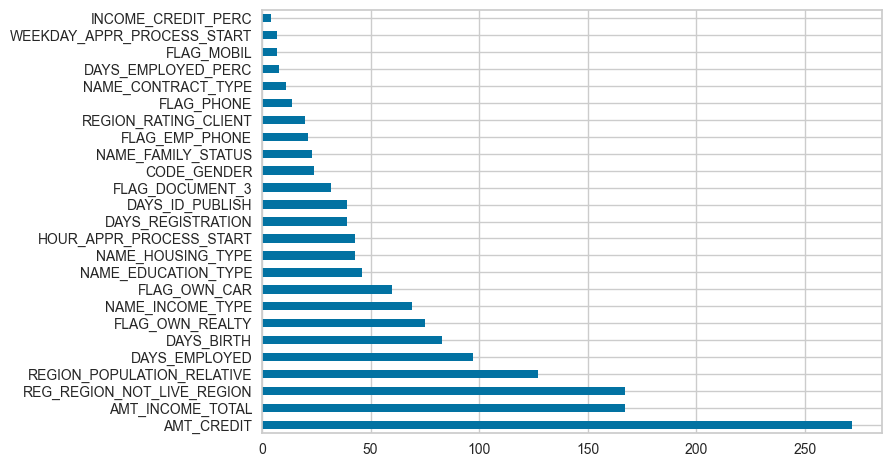

In [30]:
# calcul de la feature importance globale
features_importance = pd.Series(model.named_steps['classifier'].feature_importances_,
                                  index=X_train.columns)
features_importance.nlargest(25).plot(kind='barh', color='b', align='center')

In [18]:
features = features_importance.nlargest(55)
sorted(features.index.tolist())

['AMT_CREDIT',
 'AMT_INCOME_TOTAL',
 'CNT_CHILDREN',
 'CODE_GENDER',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_EMPLOYED_PERC',
 'DAYS_ID_PUBLISH',
 'DAYS_REGISTRATION',
 'FLAG_CONT_MOBILE',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_18',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_EMAIL',
 'FLAG_EMP_PHONE',
 'FLAG_MOBIL',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'FLAG_PHONE',
 'FLAG_WORK_PHONE',
 'HOUR_APPR_PROCESS_START',
 'INCOME_CREDIT_PERC',
 'LIVE_CITY_NOT_WORK_CITY',
 'LIVE_REGION_NOT_WORK_REGION',
 'NAME_CONTRACT_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'NAME_INCOME_TYPE',
 'ORGANIZATION_TYPE',
 'REGION_POPULATION_RELATIVE',
 '

In [159]:
# corrélations des features principales entre elles et avec la target
feats = features_importance.nlargest(25)
feats = list(feats.index)
columns = feats + ['TARGET']
train_df = train_df[columns]
profile_train_restricted = ProfileReport(train_df, title="Profil dataset training")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [160]:
profile_train_restricted.to_notebook_iframe()

### Importance locale via SHAP

In [15]:
# transformation nécessaire pour l'importance locale via SHAP
def model_predict_proba(data_asarray):
    data_asframe =  pd.DataFrame(data_asarray, columns = X_train.columns)
    return model.predict_proba(data_asframe)

In [16]:
# kernelExplainer
explainer = shap.KernelExplainer(model_predict_proba, shap.sample(X_train, 100), link='logit')

In [245]:
explainer = shap.KernelExplainer(model_predict_proba, shap.sample(X_train, 100), link='logit')

In [17]:
shap_values_single = explainer.shap_values(X_test.iloc[1, :])

In [18]:
shap_values_sample = explainer.shap_values(X_test.iloc[:1000, :])

  0%|          | 0/1000 [00:00<?, ?it/s]

In [20]:
# turning shape values explaining default to dataframe
shap_values_frame = pd.DataFrame(shap_values_sample[1], columns=X_train.columns)
shap_values_frame.head(5)

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,...,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,DAYS_EMPLOYED_PERC,INCOME_CREDIT_PERC
0,0.010269,-0.085066,0.049208,0.008711,0.007262,-0.092258,0.109540,0.023326,-0.312549,0.009894,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.007435,0.002612
1,0.004469,0.107627,0.052555,0.008964,0.020276,0.096745,0.012140,0.036959,0.072212,0.000000,...,0.0,0.0,-0.002083,0.0,0.0,0.0,0.0,0.0,0.000000,0.002593
2,0.011468,0.155751,-0.063676,0.036324,0.010792,-0.102619,0.097635,0.046719,-0.404340,-0.001478,...,0.0,0.0,0.000947,0.0,0.0,0.0,0.0,0.0,-0.003427,0.001472
3,0.006411,-0.032568,0.080886,0.006979,-0.022525,-0.092818,-0.200801,0.076397,0.117467,0.003836,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.007882,0.000000
4,0.010241,0.136927,-0.128133,-0.042476,-0.018500,-0.087312,0.167955,0.057199,0.128900,-0.001048,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.012018,0.003660


In [6]:
joblib.dump(shap_values_frame, filename='shap_sample.joblib')

['shap_sample.joblib']

In [7]:
shap_values_frame = joblib.load('shap_sample.joblib')

In [8]:
shap_values_frame.head()

AttributeError: 'list' object has no attribute 'head'

In [23]:
#joblib.dump(explainer, filename='explainer.bz2', compress=('bz2', 9))
joblib.dump(explainer, filename='explainer.joblib')

['explainer.joblib']

In [24]:
loaded_explainer = joblib.load(filename='explainer.joblib')

In [25]:
shap_values2 = loaded_explainer.shap_values(X_test.iloc[1, :])

In [29]:
np.allclose(shap_values, shap_values2, rtol=1e-03, atol=1e-02) 

True

### Choix du seuil et prédictions

#### Méthode manuelle

In [34]:
# prédictions sur validation
val_label_preds = model.predict(X_val)
val_label_preds

array([0., 0., 0., ..., 0., 0., 0.])

In [33]:
val_preds = model.predict_proba(X_val)
val_preds

array([[0.91999896, 0.08000104],
       [0.82560328, 0.17439672],
       [0.91527125, 0.08472875],
       ...,
       [0.89325525, 0.10674475],
       [0.86788572, 0.13211428],
       [0.90816745, 0.09183255]])

In [35]:
print('La probabilité de prédire un défaut sur le 1er individu de validation est de', val_preds[0,1])
print('Ce qui veut dire que la classe prédite sera "pas de défaut" pour un seuil de 0.50')

La probabilité de prédire un défaut sur le 1er individu de validation est de 0.08000104248865376
Ce qui veut dire que la classe prédite sera "pas de défaut" pour un seuil de 0.50


In [42]:
# boucle sur la valeur du seuil
new_val_label_preds = pd.DataFrame()
for threshold in np.arange(0.2, 0.8, 0.05):
    for i in range(len(val_preds)):
        if val_preds[i, 1] < threshold: new_val_label_preds.loc[i, threshold] = 1
        else: new_val_label_preds.loc[i, threshold] = 0

In [43]:
def f(x):
    try:
        return "{:.2f}".format(x)
    except:
        return x

new_val_label_preds.columns = new_val_label_preds.columns.map(f)

new_val_label_preds

,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
75635,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75636,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75637,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75638,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [44]:
for threshold in new_val_label_preds.columns:
    val = new_val_label_preds[threshold] - new_val_label_preds['0.50']
    change = val.sum()/len(new_val_label_preds)
    change = f"{change:.2%}"
    biz_score = fbeta_score(y_val, new_val_label_preds[threshold], beta=10)
    biz_score = f(biz_score)
    print('Un seuil à', threshold, 'change la classification en risque de défaut de', change)
    print('Et le score métier correspondant est de', biz_score)
    print('-'*50)

Un seuil à 0.20 change la classification en risque de défaut de -25.67%
Et le score métier correspondant est de 0.54
--------------------------------------------------
Un seuil à 0.25 change la classification en risque de défaut de -12.04%
Et le score métier correspondant est de 0.71
--------------------------------------------------
Un seuil à 0.30 change la classification en risque de défaut de -5.31%
Et le score métier correspondant est de 0.81
--------------------------------------------------
Un seuil à 0.35 change la classification en risque de défaut de -2.18%
Et le score métier correspondant est de 0.86
--------------------------------------------------
Un seuil à 0.40 change la classification en risque de défaut de -0.81%
Et le score métier correspondant est de 0.89
--------------------------------------------------
Un seuil à 0.45 change la classification en risque de défaut de -0.24%
Et le score métier correspondant est de 0.90
-----------------------------------------------

Un seuil entre 0.60 et 0.70 semble indiqué.

In [45]:
# rectification des labels prédits sur l'échantillon de test
test_preds = model.predict_proba(X_test)
test_label_preds = model.predict(X_test)
threshold = 0.70
new_test_label_preds = pd.DataFrame()
for i in range(len(test_preds)):
    if test_preds[i, 1] < threshold: new_test_label_preds.loc[i, threshold] = 1
    else: new_test_label_preds.loc[i, threshold] = 0

Une manière plus automatisée et scalable (car intégrable à une pipeline) a été trouvée ici : 
https://towardsdatascience.com/how-to-add-decision-threshold-tuning-to-your-end-to-end-ml-pipelines-7077b82b71a

#### Méthode automatisée

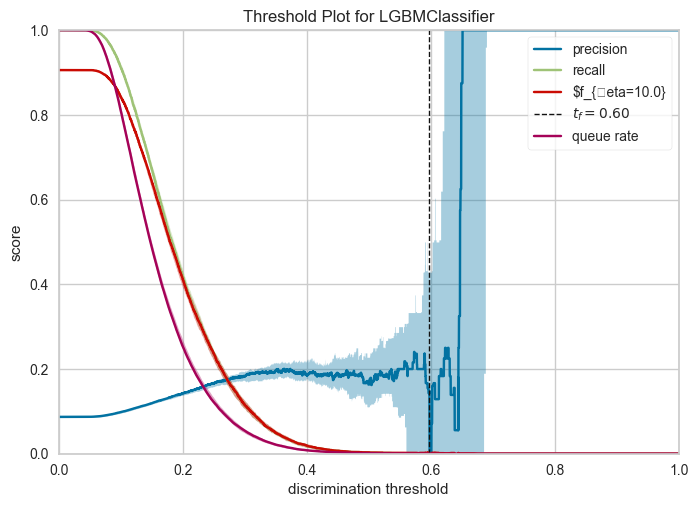

In [46]:
visualizer = DiscriminationThreshold(model, fbeta=10 ,quantiles=np.array([0.25, 0.5, 0.75]))

visualizer.fit(X_train2, y_train2)
visualizer.show(); 

In [47]:
# identification du meilleur seuil
f_scores = visualizer.cv_scores_[visualizer.argmax]
f_scores = ma.getdata(f_scores)

for k in range(0,len(f_scores)-1):
    highest_score = f_scores[0]
    increment = 1/len(f_scores)
    if f_scores[k] < 0.95 * highest_score:
        best_index = k-1
        break
    else:
        best_index = k
    best_threshold = best_index*increment
print(best_threshold)
print(best_index)
print(f_scores[best_index])

0.09405099150141644
1660
0.8607205393362486


On voit que le score business (f10_score) baisse significativement à partir d'une valeur de seuil entre 0.20 et 0.25.

In [185]:
pipe = Thresholder(model, best_threshold, refit=False)
pipe.fit(X_train, y_train)

Thresholder(model=Pipeline(steps=[('sampler', SMOTE(random_state=42)),
                                  ('scaler', StandardScaler()),
                                  ('classifier',
                                   LGBMClassifier(max_depth=8, n_estimators=10,
                                                  n_jobs=-1, verbose=-1))]),
            threshold=0.24136752136752138)

In [186]:
preds = pipe.predict(X_val)

f10_score = fbeta_score(y_val, preds, beta=10)
print ('au seuil de :', best_threshold, ', on obtient un score de :', f10_score)

au seuil de : 0.24136752136752138 , on obtient un score de : 0.8492333973328299


Train samples: 307511, test samples: 48744


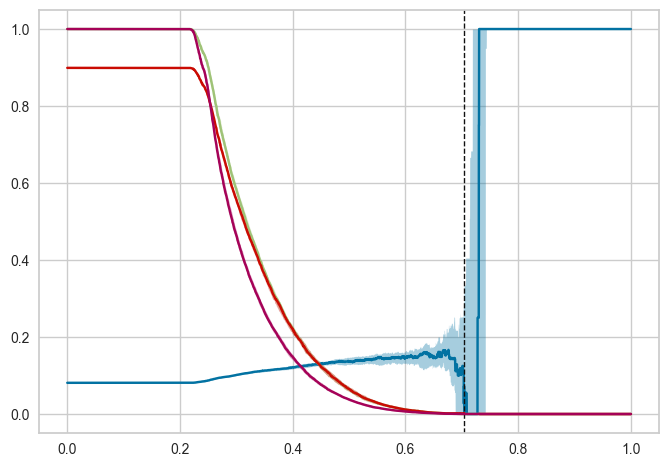

In [190]:
# classifier optimisé
sampling = SMOTE(random_state=42)
scaler = StandardScaler()
clf = LGBMClassifier(n_estimators=10, learning_rate=0.1,
                     max_depth = 8, verbose=-1, n_jobs=-1)

# Use the fluent API to set the tracking uri and the active experiment
mlflow.set_tracking_uri("http://127.0.0.1:5000")

# Sets the current active experiment to the "Apple_Models" experiment and returns the Experiment metadata
client_scoring_experiment = mlflow.set_experiment("Decision_Threshold")

# Define a run name for this iteration of training.
run_name = "best decision threshold"

# Define an artifact path that the model will be saved to.
artifact_path = "best decision threshold"

# préparation des données
X_train, y_train, X_test = prep_data(sampling=sampling)

## création d'un dataset de validation
#X_train2, X_val, y_train2, y_val = train_test_split(X_train, y_train,
#                                                  random_state=42, test_size=0.3,
#                                                  stratify=y_train)

# définition d'une pipeline
steps = [('preprocessing', preprocessor), ('sampler', sampling), ('classifier', clf)]

model = Pipeline(steps=steps)

# cross validation
folds = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)

# entraînement du modèle avec cross validation et récupération des scores
scores = avg_score_cv_classif(model, X_train, y_train, cv=folds, scoring=scoring)

# recherche du meilleur seuil
visualizer = DiscriminationThreshold(model, fbeta=10 ,quantiles=np.array([0.25, 0.5, 0.75]))
visualizer.fit(X_train, y_train)

f_scores = visualizer.cv_scores_[visualizer.argmax]
f_scores = ma.getdata(f_scores)

for k in range(0,len(f_scores)-1):
    highest_score = f_scores[0]
    increment = 1/len(f_scores)
    if f_scores[k] < 0.95 * highest_score:
        best_index = k-1
        break
    else:
        best_index = k
    best_threshold = best_index*increment

pipe = Thresholder(model, best_threshold, refit=False)

# fit du modèle
pipe.fit(X_train, y_train)


# Initiate the MLflow run context
with mlflow.start_run(run_name=run_name) as run:
    # Log the parameters used for the model fit
    #mlflow.log_params(params)
    mlflow.log_param('classifier', clf)
    mlflow.log_param('sampler', sampling)
    mlflow.log_param('threshold', best_threshold)

    # Log the error metrics that were calculated during validation
    mlflow.log_metrics(scores)

    # Log an instance of the trained model for later use
    mlflow.sklearn.log_model(sk_model=pipe, input_example=X_train, artifact_path=artifact_path)

In [316]:
np.subtract(shap_values,shap_values2)

array([[-0.00377286, -0.01031422,  0.00098067, -0.00455764,  0.01192231,
         0.        ,  0.00867911, -0.00361705,  0.00249067,  0.        ,
         0.00190779,  0.        ,  0.        ,  0.00355491,  0.        ,
        -0.00430431,  0.        , -0.00328785, -0.0035748 ,  0.00493108,
         0.00709191,  0.00216309,  0.        ,  0.0053962 , -0.00192671,
         0.        ,  0.        ,  0.        ,  0.        ,  0.01014904,
        -0.00101325,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.00511744,  0.        ,
         0.        ,  0.        , -0.0108163 ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        , -0.00697201,
         0.        ,  0.        ,  0.        , -0.00396738,  0.00266827,
         0.        , -0.0031083 ,  0.        ,  0.        , -0.001395  ,
         0.        ,  0.00241264,  0.        , -0.00875637, -0.00080609,
        -0.00625407, -0.00010954,  0.00585913, -0.0

In [309]:
shap.initjs()
shap.force_plot(explainer.expected_value[0],shap_values[0], X_test.columns.tolist(),link='logit', out_names='risque de défaut')

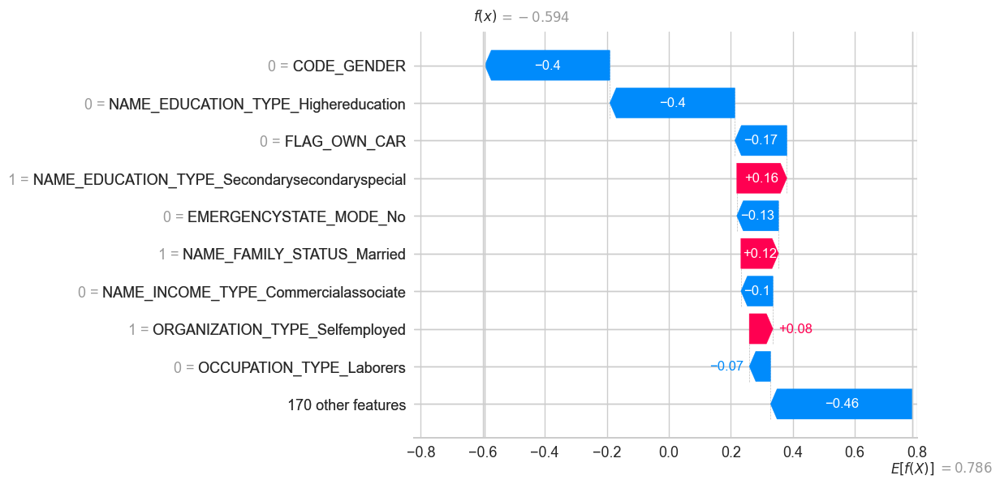

In [274]:
shap.waterfall_plot(shap.Explanation(values=np.array(shap_values[0]), 
                                         base_values=explainer.expected_value[0], 
                                         data=X_test.iloc[1,:],  # added this line
                                         feature_names=X_test.columns.tolist()))

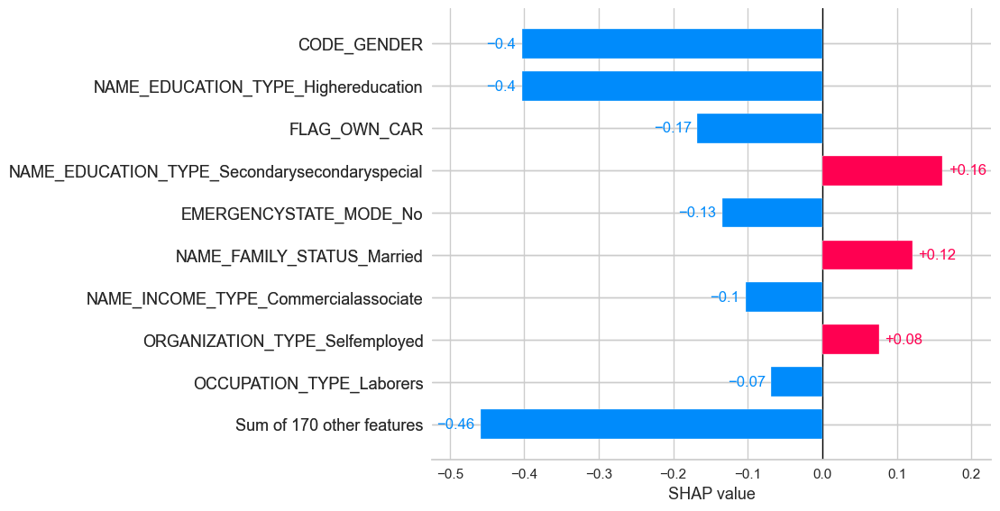

In [280]:
shap.plots.bar(shap.Explanation(values=np.array(shap_values[0]), 
                                         base_values=explainer.expected_value[0], 
                                         #data=X_test.iloc[1,:],  # added this line
                                         feature_names=X_test.columns.tolist()))

## Mise en production du modèle

In [84]:
# sérialisation du modèle via joblib puisque nous avons un gros dataset
import joblib
joblib.dump(model, 'model_scoring.joblib')

['model_scoring.joblib']

In [85]:
scoring_model = joblib.load('model_scoring.joblib')

In [86]:
def scoring_pred(input_parameters):
    input_data = input_parameters.json()
    input_dict = json.loads(input_data)

    inp0 = input_dict['NAME_CONTRACT_TYPE']
    inp1 = input_dict['NAME_INCOME_TYPE']
    inp2 = input_dict['NAME_EDUCATION_TYPE']
    inp3 = input_dict['NAME_FAMILY_STATUS']
    inp4 = input_dict['NAME_HOUSING_TYPE']
    inp5 = input_dict['WEEKDAY_APPR_PROCESS_START']
    inp6 = input_dict['ORGANIZATION_TYPE']
    inp7 = input_dict['CODE_GENDER']
    inp8 = input_dict['FLAG_OWN_CAR']
    inp9 = input_dict['FLAG_OWN_REALTY']
    inp10 = input_dict['CNT_CHILDREN']
    inp11 = input_dict['AMT_INCOME_TOTAL']
    inp12 = input_dict['AMT_CREDIT']
    inp13 = input_dict['REGION_POPULATION_RELATIVE']
    inp14 = input_dict['DAYS_BIRTH']
    inp15 = input_dict['DAYS_EMPLOYED']
    inp16 = input_dict['DAYS_REGISTRATION']
    inp17 = input_dict['DAYS_ID_PUBLISH']
    inp18 = input_dict['FLAG_MOBIL']
    inp19 = input_dict['FLAG_EMP_PHONE']
    inp20 = input_dict['FLAG_WORK_PHONE']
    inp21 = input_dict['FLAG_CONT_MOBILE']
    inp22 = input_dict['FLAG_PHONE']
    inp23 = input_dict['FLAG_EMAIL']
    inp24 = input_dict['REGION_RATING_CLIENT']
    inp25 = input_dict['REGION_RATING_CLIENT_W_CITY']
    inp26 = input_dict['HOUR_APPR_PROCESS_START']
    inp27 = input_dict['REG_REGION_NOT_LIVE_REGION']
    inp28 = input_dict['REG_REGION_NOT_WORK_REGION']
    inp29 = input_dict['LIVE_REGION_NOT_WORK_REGION']
    inp30 = input_dict['REG_CITY_NOT_LIVE_CITY']
    inp31 = input_dict['REG_CITY_NOT_WORK_CITY']
    inp32 = input_dict['LIVE_CITY_NOT_WORK_CITY']
    inp33 = input_dict['FLAG_DOCUMENT_2']
    inp34 = input_dict['FLAG_DOCUMENT_3']
    inp35 = input_dict['FLAG_DOCUMENT_4']
    inp36 = input_dict['FLAG_DOCUMENT_5']
    inp37 = input_dict['FLAG_DOCUMENT_6']
    inp38 = input_dict['FLAG_DOCUMENT_7']
    inp39 = input_dict['FLAG_DOCUMENT_8']
    inp40 = input_dict['FLAG_DOCUMENT_9']
    inp41 = input_dict['FLAG_DOCUMENT_10']
    inp42 = input_dict['FLAG_DOCUMENT_11']
    inp43 = input_dict['FLAG_DOCUMENT_12']
    inp44 = input_dict['FLAG_DOCUMENT_13']
    inp45 = input_dict['FLAG_DOCUMENT_14']
    inp46 = input_dict['FLAG_DOCUMENT_15']
    inp47 = input_dict['FLAG_DOCUMENT_16']
    inp48 = input_dict['FLAG_DOCUMENT_17']
    inp49 = input_dict['FLAG_DOCUMENT_18']
    inp50 = input_dict['FLAG_DOCUMENT_19']
    inp51 = input_dict['FLAG_DOCUMENT_20']
    inp52 = input_dict['FLAG_DOCUMENT_21']
    inp53 = input_dict['DAYS_EMPLOYED_PERC']
    inp54 = input_dict['INCOME_CREDIT_PERC']

    input_list = [inp0, inp1, inp2, inp3, inp4, inp5, inp6, inp7, inp8, inp9, 
                  inp10, inp11, inp12, inp13, inp14, inp15, inp16, inp17, inp18, inp19, 
                  inp20, inp21, inp22, inp23, inp24, inp25, inp26, inp27, inp28, inp29, 
                  inp30, inp31, inp32, inp33, inp34, inp35, inp36, inp37, inp38, inp39, 
                  inp40, inp41, inp42, inp43, inp44, inp45, inp46, inp47, inp48, inp49, 
                  inp50, inp51, inp52, inp53, inp54]


    prediction = scoring_model.predict([input_list])

    print(prediction)

In [108]:
ordered_cols = ["NAME_CONTRACT_TYPE",
"NAME_INCOME_TYPE",
"NAME_EDUCATION_TYPE",
"NAME_FAMILY_STATUS",
"NAME_HOUSING_TYPE",
"WEEKDAY_APPR_PROCESS_START",
"ORGANIZATION_TYPE",
"CODE_GENDER",
"FLAG_OWN_CAR",
"FLAG_OWN_REALTY",
"CNT_CHILDREN",
"AMT_INCOME_TOTAL",
"AMT_CREDIT",
"REGION_POPULATION_RELATIVE",
"DAYS_BIRTH",
"DAYS_EMPLOYED",
"DAYS_REGISTRATION",
"DAYS_ID_PUBLISH",
"FLAG_MOBIL",
"FLAG_EMP_PHONE",
"FLAG_WORK_PHONE",
"FLAG_CONT_MOBILE",
"FLAG_PHONE",
"FLAG_EMAIL",
"REGION_RATING_CLIENT",
"REGION_RATING_CLIENT_W_CITY",
"HOUR_APPR_PROCESS_START",
"REG_REGION_NOT_LIVE_REGION",
"REG_REGION_NOT_WORK_REGION",
"LIVE_REGION_NOT_WORK_REGION",
"REG_CITY_NOT_LIVE_CITY",
"REG_CITY_NOT_WORK_CITY",
"LIVE_CITY_NOT_WORK_CITY",
"FLAG_DOCUMENT_2",
"FLAG_DOCUMENT_3",
"FLAG_DOCUMENT_4",
"FLAG_DOCUMENT_5",
"FLAG_DOCUMENT_6",
"FLAG_DOCUMENT_7",
"FLAG_DOCUMENT_8",
"FLAG_DOCUMENT_9",
"FLAG_DOCUMENT_10",
"FLAG_DOCUMENT_11",
"FLAG_DOCUMENT_12",
"FLAG_DOCUMENT_13",
"FLAG_DOCUMENT_14",
"FLAG_DOCUMENT_15",
"FLAG_DOCUMENT_16",
"FLAG_DOCUMENT_17",
"FLAG_DOCUMENT_18",
"FLAG_DOCUMENT_19",
"FLAG_DOCUMENT_20",
"FLAG_DOCUMENT_21",
"DAYS_EMPLOYED_PERC",
"INCOME_CREDIT_PERC"
]

In [109]:
def model_predict_proba_API(data_asarray):
    data_asframe =  pd.DataFrame(data_asarray, columns = ordered_cols)
    return model.predict_proba(data_asframe)

In [110]:
model_predict_proba_API([
  [
    "Cash loans",
    "Working",
    "Higher education",
    "Married",
    "House / apartment",
    "TUESDAY",
    "Kindergarten",
    0,
    0,
    0,
    0,
    135000,
    568800,
    0.01885,
    -19241,
    -2329,
    -5170,
    -812,
    1,
    1,
    0,
    1,
    0,
    1,
    2,
    2,
    18,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    1,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0.1210436048022452,
    0.23734177215189872
  ]
]
)

array([[0.85027198, 0.14972802]])

## Data drift

In [36]:
# pré-traitement sans risque de data leakage
data_ref = pd.read_csv('./application_train.csv').drop(['SK_ID_CURR'],
                                                               axis=1)
data_cur = pd.read_csv('./application_test.csv').drop(['SK_ID_CURR'],
                                                              axis=1)

data_cur['TARGET'] = test_label_preds
data_cur

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,...,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,TARGET
0,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,...,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0,1.0
2,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,...,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0,0.0
3,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,...,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0,0.0
4,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,Unaccompanied,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48739,Cash loans,F,N,Y,0,121500.0,412560.0,17473.5,270000.0,Unaccompanied,...,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
48740,Cash loans,F,N,N,2,157500.0,622413.0,31909.5,495000.0,Unaccompanied,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,0.0
48741,Cash loans,F,Y,Y,1,202500.0,315000.0,33205.5,315000.0,Unaccompanied,...,0,0,0,0.0,0.0,0.0,0.0,3.0,1.0,0.0
48742,Cash loans,M,N,N,0,225000.0,450000.0,25128.0,450000.0,Family,...,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0,0.0


In [ ]:
# A SUPPRIMER
#dataset-level metrics
data_drift_dataset_report = Report(metrics=[
    DataDriftTable(num_stattest='kl_div', cat_stattest='psi'),
])

data_drift_dataset_report.run(reference_data=data_ref, current_data=data_cur)
data_drift_dataset_report

In [37]:
# full report
data_drift_report = Report(metrics=[
    DataDriftPreset(),
])

data_drift_report.run(reference_data=data_ref, current_data=data_cur, column_mapping=None)
data_drift_report

In [ ]:
# sauvegarde au format html
data_drift_report.save_html("drift_report.html")

## A archiver

### Déploiement via MLFlow

In [214]:
# signature du modèle
from mlflow.models.signature import infer_signature
signature = infer_signature(X_train, y_train)

In [216]:
# sauvegarde du modèle
import mlflow.sklearn
mlflow.sklearn.save_model(pipe, 'mlflow_model', signature=signature)

In [ ]:
# déploiement d'une API REST
!mlflow models serve -m my_model
!curl http://127.0.0.1:5000/invocations -H 'Content-Type: application/json' -d '{"data": [[1, 2, 3, 4, 5, 6, 7, 8]]}'

### Pre-processing sur fichiers non utilisés

In [ ]:
# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(num_rows = None, nan_as_category = True):
    bureau = pd.read_csv('../Kaggle/bureau.csv', nrows = num_rows)
    bb = pd.read_csv('../Kaggle/bureau_balance.csv', nrows = num_rows)
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)

    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()

    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']

    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

In [ ]:
# Preprocess previous_applications.csv
def previous_applications(num_rows = None, nan_as_category = True):
    prev = pd.read_csv('../Kaggle/previous_application.csv', nrows = num_rows)
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']

    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

In [ ]:
# Preprocess POS_CASH_balance.csv
def pos_cash(num_rows = None, nan_as_category = True):
    pos = pd.read_csv('../Kaggle/POS_CASH_balance.csv', nrows = num_rows)
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']

    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg

In [ ]:
# Preprocess installments_payments.csv
def installments_payments(num_rows = None, nan_as_category = True):
    ins = pd.read_csv('../Kaggle/installments_payments.csv', nrows = num_rows)
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

In [ ]:
# Preprocess credit_card_balance.csv
def credit_card_balance(num_rows = None, nan_as_category = True):
    cc = pd.read_csv('../Kaggle/credit_card_balance.csv', nrows = num_rows)
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

In [ ]:
# préparation des données
sampling = SMOTE(random_state=42) # gestion de l'équilibrage des classes

X_train, y_train, class_weight = prep_data(sampling)

# instanciation d'une méthode de standardisation
scaler = StandardScaler()

# options de classifieurs
clf = DummyClassifier()
#clf = DecisionTreeClassifier()
#clf = RandomForestClassifier(n_estimators=10, n_jobs=-1)
#clf = SVC() #trop long
#clf = LGBMClassifier(n_estimators=100, verbose=-1, n_jobs=-1, class_weight= class_weight) #tenté à 1000 sans amélioration des résultats

# définition d'une pipeline
steps = [('sampler', sampling), ('scaler', scaler), ('classifier', clf)]

model = Pipeline(steps=steps)

# cross validation
folds = StratifiedKFold(n_splits= 10, shuffle=True, random_state=0)

# entraînement du modèle avec cross validation et récupération des scores
scores = avg_score_cv_classif(model, X_train, y_train, cv=folds, scoring=scoring)

new_row = {'classifier':estimator_name(clf), 'sampler': 'smote',
           'fit and score time': scores['fit_time'] + scores['score_time'], 'accuracy': scores['test_accuracy'],
           'auc': scores['test_auc'], 'business score': scores['test_f10_score']
           }

results = results.append(new_row, ignore_index=True)
results

Train samples: 307511, test samples: 48744


,classifier,sampler,fit and score time,accuracy,auc,business score
0,DummyClassifier,smote,34.08568,0.91927,0.5,0.91847


In [ ]:
def main(debug = False, balance=None):
    num_rows = 1000 if debug else None
    df = application_train_test(num_rows)
    with timer("Run LightGBM"):
        feat_importance = kfold_lightgbm(df, num_folds= 2, debug= debug, balance=balance)

In [ ]:
if __name__ == "__main__":
    submission_file_name = "lgbm_results01.csv"
    with timer("Full model run"):
        main(debug= True, balance= 'class_weight')

Train samples: 1000, test samples: 1000
Starting LightGBM. Train shape: (1000, 235), test shape: (1000, 235)
Run LightGBM - done in 4s
Full model run - done in 4s


### DummyClassifier

In [ ]:
# Dummy classifier
def dummy_classifier(df, debug = False):
    # Divide in training/validation and test data
    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    train_df = df[df['TARGET'].notnull()]
    test_df = df[df['TARGET'].isnull()]
    print("Starting DummyClassifier. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()

    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    #sub_preds = np.zeros(test_df.shape[0])
    #feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]

    train_x, valid_x, train_y, valid_y = train_test_split(train_df[feats], train_df['TARGET'], test_size=0.3, random_state=21)

    clf = DummyClassifier()

    clf.fit(train_x, train_y, ) #eval_metric= 'auc', verbose= 200, early_stopping_rounds= 200
    #feature_importance_df = pd.DataFrame()
    #feature_importance_df["feature"] = feats
    #feature_importance_df["importance"] = clf.feature_importances_

    oof_preds = clf.predict(valid_x)
    sub_preds = clf.predict(test_df[feats])

    #print('Score : %.4f' % biz_loss(valid_y, oof_preds))

    cm = confusion_matrix(valid_y, oof_preds, labels=clf.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
    disp.plot()
    plt.show()

    del clf, train_x, train_y, valid_x, valid_y
    gc.collect()

    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    #display_importances(feature_importance_df)
    #return feature_importance_df

In [ ]:
def dummy_classifier(df, num_folds, debug= False):
    # Divide in training/validation and test data
    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    train_df = df[df['TARGET'].notnull()]
    train_df = train_df.dropna(axis=1)
    test_df = df[df['TARGET'].isnull()]
    print("Starting DummyClassifier. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()
    # Cross validation model
    folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=1001)

    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]

    X = train_df[feats]
    y = train_df['TARGET']

    #X, y = balance_classes(X, y)

    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(X, y)):
        train_x, train_y = train_df[feats].iloc[train_idx], train_df['TARGET'].iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], train_df['TARGET'].iloc[valid_idx]

        #
        clf = DummyClassifier()

        clf.fit(train_x, train_y#, eval_set=[(train_x, train_y), (valid_x, valid_y)],
                #eval_metric= fbeta_score(valid_y, oof_preds, beta = 10)
                )

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        print('Fold %2d business score : %.6f' % (n_fold + 1, fbeta_score(valid_y, oof_preds[valid_idx], beta = 10)))
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()

    print('Full AUC score %.6f' % roc_auc_score(train_df['TARGET'], oof_preds))
    print('Full business score %.6f' % fbeta_score(train_df['TARGET'], oof_preds, beta = 10))

    cm = confusion_matrix(valid_y, oof_preds, labels=clf.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
    disp.plot()
    plt.show()

    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    display_importances(feature_importance_df)
    return feature_importance_df

In [ ]:
def main(debug = False):
    num_rows = 10000 if debug else None
    df = application_train_test(num_rows)
    with timer("Run DummyClassifier"):
        #feat_importance = kfold_lightgbm(df, num_folds= 10, stratified= False, debug= debug)
        feat_importance = dummy_classifier(df, num_folds= 10, debug= debug)

In [ ]:
if __name__ == "__main__":
    submission_file_name = "dummy_results01.csv"
    with timer("Dummy model run"):
        main(debug= True)

Train samples: 10000, test samples: 10000
Starting DummyClassifier. Train shape: (10000, 186), test shape: (10000, 246)


AttributeError: ignored

Train samples: 307511, test samples: 48744
Starting DummyClassifier. Train shape: (307507, 248), test shape: (48744, 248)


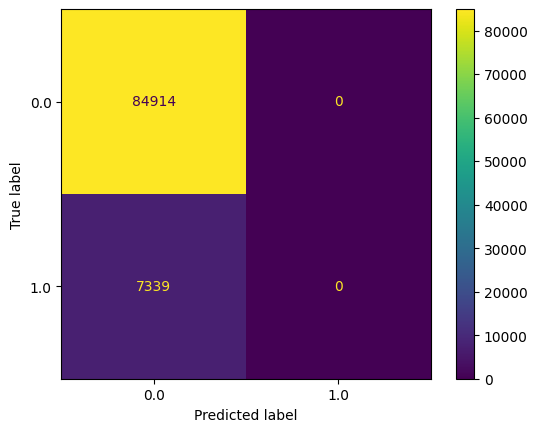

Run DummyClassifier - done in 2s
Dummy model run - done in 11s


In [ ]:
if __name__ == "__main__":
    submission_file_name = "dummy_results01.csv"
    with timer("Dummy model run"):
        main(debug= False)

### Autres sections

In [ ]:
def old_main(debug = False):
    num_rows = 10000 if debug else None
    df = application_train_test(num_rows)
    with timer("Process bureau and bureau_balance"):
        bureau = bureau_and_balance(num_rows)
        print("Bureau df shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Process previous_applications"):
        prev = previous_applications(num_rows)
        print("Previous applications df shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Process POS-CASH balance"):
        pos = pos_cash(num_rows)
        print("Pos-cash balance df shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Process installments payments"):
        ins = installments_payments(num_rows)
        print("Installments payments df shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Process credit card balance"):
        cc = credit_card_balance(num_rows)
        print("Credit card balance df shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
    with timer("Run LightGBM with kfold"):
        feat_importance = kfold_lightgbm(df, num_folds= 10, stratified= False, debug= debug)

In [ ]:
# méthode de sampling retenue
X_train = X_train.dropna(axis=1)
sampling = SMOTE(random_state=42)
class_weight = 'balanced'

# instanciation d'une méthode de standardisation
scaler = StandardScaler()

# classifier retenu
clf = LGBMClassifier(n_estimators=100, verbose=-1, n_jobs=-1, class_weight= class_weight)

# définition d'une pipeline
steps = [('sampler', sampling), ('scaler', scaler), ('classifier', clf)]

model = Pipeline(steps=steps)

# entraînement du modèle avec cross validation et récupération des scores
scores = avg_score_cv_classif(model, X_train, y_train, cv=folds, scoring=scoring)

new_row = {'classifier':estimator_name(clf), 'sampler': 'smote + class weight',
           'fit and score time': scores['fit_time'] + scores['score_time'], 'accuracy': scores['test_accuracy'],
           'auc': scores['test_auc'], 'business score': scores['test_f10_score']
           }

results = results.append(new_row, ignore_index=True)
results

,classifier,sampler,fit and score time,accuracy,auc,business score
0,DummyClassifier,smote,32.44399,0.91927,0.50000,0.91847
1,LGBMClassifier,over,22.31116,0.62636,0.65672,0.62653
2,LGBMClassifier,smote,39.31066,0.90193,0.59237,0.90141
3,LGBMClassifier,under,3.33454,0.62646,0.65445,0.62662
4,LGBMClassifier,class weight,18.17182,0.68105,0.73418,0.68115
5,LGBMClassifier,smote + class weight,41.63248,0.90193,0.59237,0.90141


In [ ]:
# A SUPPRIMER Définition d'une fonction d'évaluation du coût métier
def biz_loss(y_true, y_pred):
  costs = np.array([10,1,0,0]) # FP, FN, TP, TN
  nsamples = len(y_true)
  cost_mat = np.repeat(costs, nsamples, axis=0) #ne fonctionne pas pour créer l'array à nsamples lignes
  loss = cost_loss(y_true, y_pred, cost_mat)
  return loss

In [ ]:
# LightGBM GBDT with KFold or Stratified KFold
# Parameters from Tilii kernel: https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
def kfold_lightgbm(df, num_folds, debug= False, balance= 'SMOTE'):
    # Divide in training/validation and test data
    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    train_df = df[df['TARGET'].notnull()]
    test_df = df[df['TARGET'].isnull()]
    print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()

    # gestion de balance des classes
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    X_train = train_df[feats]
    y_train = train_df['TARGET']

    X_train = X_train.dropna(axis=1)

    if balance == 'smote':
        X_train, y_train = balance_classes(X_train, y_train, smote= True)
        class_weight = None
    elif balance == 'rand_ow':
        X_train, y_train = balance_classes(X_train, y_train, smote= False)
        class_weight = None
    elif balance == 'class_weight':
        class_weight = 'balanced'
    else: class_weight = None

    feats = [f for f in X_train.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    X_test = test_df[feats]

    # Cross validation avec gestion de balance des classes
    folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=0)

    # Create arrays and dataframes to store results
    oof_preds = np.zeros(X_train.shape[0])
    oof_pred_labels = np.zeros(X_train.shape[0])
    sub_preds = np.zeros(X_test.shape[0])
    feature_importance_df = pd.DataFrame()

    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(X_train, y_train)):
        train_x, train_y = X_train.iloc[train_idx], y_train.iloc[train_idx]
        valid_x, valid_y = X_train.iloc[valid_idx], y_train.iloc[valid_idx]

        # LightGBM parameters found by Bayesian optimization
        clf = LGBMClassifier(
            #nthread=4,
            n_estimators=10000,
            #learning_rate=0.02,
            #num_leaves=34,
            #colsample_bytree=0.9497036,
            #subsample=0.8715623,
            #max_depth=8,
            #reg_alpha=0.041545473,
            #reg_lambda=0.0735294,
            #min_split_gain=0.0222415,
            #min_child_weight=39.3259775,
            #silent=-1,
            verbose=-1,
            class_weight= class_weight
            )

        clf.fit(train_x, train_y, eval_set=[(train_x, train_y), (valid_x, valid_y)],
                eval_metric= 'auc',
                #early_stopping_rounds= 200, verbose= 200,
                )

        oof_preds[valid_idx] = clf.predict_proba(valid_x)[:, 1]
        oof_pred_labels[valid_idx] = clf.predict(valid_x)[1]
        sub_preds += clf.predict_proba(X_test)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_pred_labels[valid_idx])))
        print('Fold %2d business score : %.6f' % (n_fold + 1, fbeta_score(valid_y, oof_pred_labels[valid_idx], average='weighted', beta = 10)))

        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()

    print('Full AUC score %.6f' % roc_auc_score(y_train, oof_preds))
    print('Full business score %.6f' % fbeta_score(y_train, oof_pred_labels, average='weighted', beta = 10))

    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    #display_importances(feature_importance_df)
    return feature_importance_df

In [ ]:
# LightGBM GBDT with KFold or Stratified KFold
# Parameters from Tilii kernel: https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
def kfold_lightgbm(df, num_folds, debug= False, balance= 'SMOTE'):
    # Split entre training et test data
    df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    train_df = df[df['TARGET'].notnull()]
    test_df = df[df['TARGET'].isnull()]
    print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()

    # Split entre training et validation data
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    X_train, X_val, y_train, y_val = train_test_split(train_df[feats],
                                                      train_df['TARGET'],
                                                      test_size=0.33,
                                                      random_state=42)
    # gestion de balance des classes
    X_train = train_df[feats]
    y_train = train_df['TARGET']

    X_train = X_train.dropna(axis=1)

    if balance == 'smote':
        X_train, y_train = balance_classes(X_train, y_train, smote= True)
        class_weight = None
    elif balance == 'rand_ow':
        X_train, y_train = balance_classes(X_train, y_train, smote= False)
        class_weight = None
    elif balance == 'class_weight':
        class_weight = 'balanced'
    else: class_weight = None

    feats = [f for f in X_train.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    X_val = X_val[feats]

    # LightGBM parameters
    clf = LGBMClassifier(
        n_estimators=10000,
        verbose=-1,
        class_weight= class_weight
        )

    clf.fit(X_train, y_train)

    # Cross validation avec gestion de balance des classes
    folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=0)


    scores = avg_score_cv_classif(clf, X_val, y_val, cv=folds, scoring=scoring)
    return scores


In [14]:
# A SUPPRIMER
# classifier optimisé
sampling = SMOTE(random_state=42)
clf = LGBMClassifier(n_estimators=10, learning_rate=0.1, max_depth = 8, verbose=-1, n_jobs=-1)
scaler = StandardScaler()

# préparation des données
X_train, y_train, X_test = prep_data(sampling=sampling)

# définition d'une pipeline
steps = [('sampler', sampling), ('scaler', scaler), ('classifier', clf)]

model = Pipeline(steps=steps)

# cross validation
folds = StratifiedKFold(n_splits=10, shuffle=True, random_state=0)

# entraînement du modèle avec cross validation et récupération des scores
scores = avg_score_cv_classif(model, X_train, y_train, cv=folds, scoring=scoring)

model.fit(X_train, y_train)

Train samples: 307511, test samples: 48744


KeyboardInterrupt: ignored

In [ ]:
# Display/plot feature importance
def display_importances(feature_importance_df_):
    cols = feature_importance_df_[["feature", "importance"]].groupby("feature").mean().sort_values(by="importance", ascending=False)[:40].index
    best_features = feature_importance_df_.loc[feature_importance_df_.feature.isin(cols)]
    plt.figure(figsize=(8, 10))
    sns.barplot(x="importance", y="feature", data=best_features.sort_values(by="importance", ascending=False))
    plt.title('LightGBM Features (avg over folds)')
    plt.tight_layout()
    plt.savefig('lgbm_importances01.png')

In [ ]:
# importance
feature_importance_df = pd.DataFrame()
feature_importance_df["feature"] = feats
feature_importance_df["importance"] = clf.feature_importances_ #modifier avec model
display_importances(feature_importance_df)

In [7]:
# Use search_experiments() to search on the project_name tag key

client_scoring_experiment = client.search_experiments(
    filter_string="tags.`project_name` = 'client-scoring'"
)

pprint(client_scoring_experiment[0])

<Experiment: artifact_location='mlflow-artifacts:/250597260432144647', creation_time=1699445390597, experiment_id='250597260432144647', last_update_time=1699445390597, lifecycle_stage='active', name='Client_Scoring', tags={'mlflow.note.content': 'This is the client scoring project. This experiment '
                        'contains all the related models.',
 'project_name': 'client-scoring'}>


In [236]:
X_train.iloc[:, 121: 200].dtypes

ORGANIZATION_TYPE_Industrytype12           uint8
ORGANIZATION_TYPE_Industrytype13           uint8
ORGANIZATION_TYPE_Industrytype2            uint8
ORGANIZATION_TYPE_Industrytype3            uint8
ORGANIZATION_TYPE_Industrytype4            uint8
ORGANIZATION_TYPE_Industrytype5            uint8
ORGANIZATION_TYPE_Industrytype6            uint8
ORGANIZATION_TYPE_Industrytype7            uint8
ORGANIZATION_TYPE_Industrytype8            uint8
ORGANIZATION_TYPE_Industrytype9            uint8
ORGANIZATION_TYPE_Insurance                uint8
ORGANIZATION_TYPE_Kindergarten             uint8
ORGANIZATION_TYPE_LegalServices            uint8
ORGANIZATION_TYPE_Medicine                 uint8
ORGANIZATION_TYPE_Military                 uint8
ORGANIZATION_TYPE_Mobile                   uint8
ORGANIZATION_TYPE_Other                    uint8
ORGANIZATION_TYPE_Police                   uint8
ORGANIZATION_TYPE_Postal                   uint8
ORGANIZATION_TYPE_Realtor                  uint8
ORGANIZATION_TYPE_Re

In [ ]:
# predictions from model via API call (via MLFlow)

def request_prediction(model_uri, data):
    headers = {"Content-Type": "application/json"}

    #data_json = {'data': data}
    #data_json = data.to_json()
    response = requests.request(
        method='POST', headers=headers, url=model_uri, json=data)

    if response.status_code != 200:
        raise Exception(
            "Request failed with status {}, {}".format(response.status_code, response.text))

    return response.json()


MLFLOW_URI = 'http://127.0.0.1:5000/invocations'
response_mlflow = request_prediction(MLFLOW_URI, transformed_candidate_data.to_dict(orient='records')[0])
st.json(response_mlflow)